In [5]:
import os
current_directory = os.getcwd()
print(f"Current Working Directory: {current_directory}")

from Tusc5ImageUtils import *
import numpy as np
from urllib.parse import urlparse
import matplotlib.pyplot as plt
import matplotlib as mpl
from skimage import exposure
mpl.rcParams['figure.dpi'] = 300
from cellpose import utils, io, plot, models, denoise
from scipy.ndimage import binary_erosion, binary_fill_holes, center_of_mass
import subprocess
import pandas as pd
import nd2
from skimage.measure import regionprops

Current Working Directory: d:\Lab Analysis PC\ImageAnalysis


In [6]:
### Directory Configuration ###

parent_directory = os.path.dirname(current_directory) # Parent directory
test_stacks_directory = os.path.join(parent_directory, 'Test Stacks')

model_path_dapi = os.path.join(parent_directory, 'ImageAnalysis/cellpose_models/T5_DAPI_V3')
img_path = os.path.join(test_stacks_directory, '2007R_GLUT1_647_WGA_594_0002.nd2')
# BLURRY IMAGE img_path = os.path.join(test_stacks_directory, '3203R_GLUT1_647_WGA_594_0002.nd2')

In [7]:
### Image Insertion ###

f = nd2.ND2File(img_path)
image = to_8bit(f.asarray())

DAPI_stack = image[:,0,:,:].copy()
eGFP_stack = image[:,1,:,:].copy()
GLUT1_stack = image[:,3,:,:].copy()
WGA_stack = image[:,2,:,:].copy()


mp_DAPI = max_proj(DAPI_stack)
model = models.CellposeModel(pretrained_model='cyto3')
DAPI_masks, flows, styles = model.eval(mp_DAPI, diameter=90, channels=[0,0])

C:\Users\Luis\AppData\Local\Temp\ipykernel_15680\3451992100.py:3: UserWarning: ND2File file not closed before garbage collection. Please use `with ND2File(...):` context or call `.close()`.
  f = nd2.ND2File(img_path)


In [8]:
coords_3d = nuclei_centers_of_mass(DAPI_stack, DAPI_masks)

c:\Users\Luis\anaconda3\envs\cellpose\lib\site-packages\scipy\ndimage\_measurements.py:1407: RuntimeWarning: invalid value encountered in scalar divide
  results = [sum(input * grids[dir].astype(float), labels, index) / normalizer


(-0.5, 1023.5, 1023.5, -0.5)

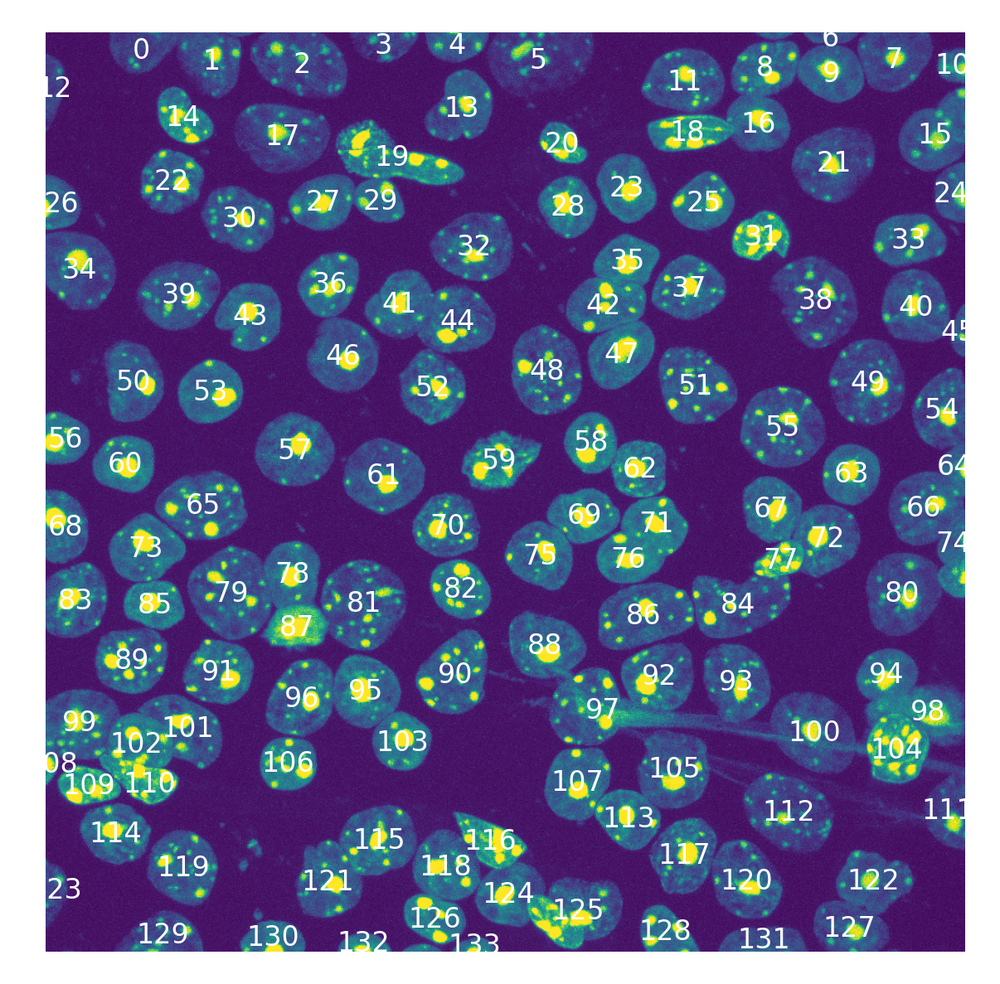

In [9]:
DAPI_coords = get_nuclei_position(DAPI_masks)
plt.imshow(mp_DAPI)
plot_maskids(DAPI_coords, text_color = 'white', font_size= 8)
plt.axis('off')

(-0.5, 1023.5, 1023.5, -0.5)

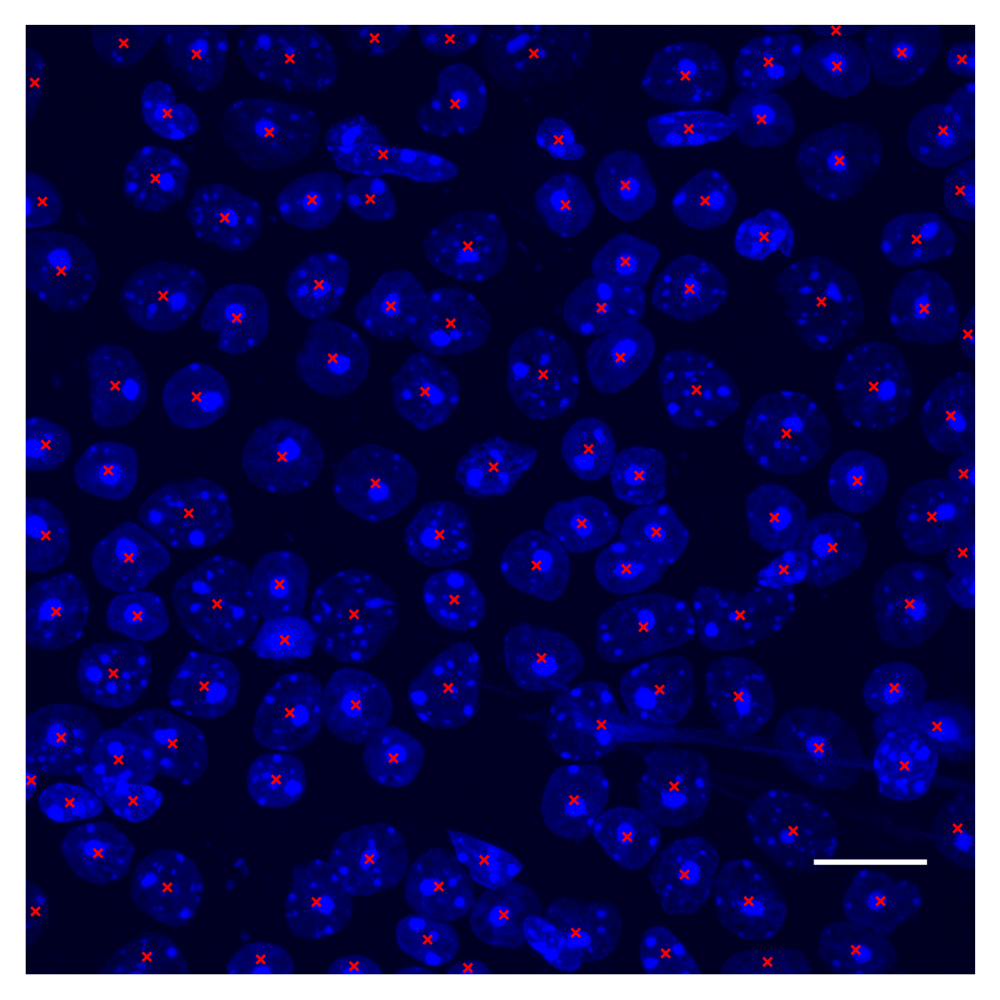

In [10]:
coords_2d = [(i[0], i[1]) for i in coords_3d]
x_coords = [i[0] for i in coords_2d]
y_coords = [i[1] for i in coords_2d]

ax = grey_to_color(mp_DAPI, color = 'blue')
ax = add_scale_bar(ax, .123, 15, 850, 900)
plt.imshow(ax)
plt.scatter(y_coords, x_coords, marker = 'x', c = 'red', s = 6, linewidths= .75)
plt.axis('off')

In [12]:
import tifffile as tiff

stack_dir = os.path.join(parent_directory, 'vis_stacks')

z_avg = np.mean([i[2] for i in coords_3d]).astype(int)

for i in [z_avg, z_avg +3, z_avg + 6, z_avg + 9, z_avg + 12, z_avg + 15, z_avg + 18]:

    slice = WGA_stack[i, :,:]
    slice = grey_to_color(slice, 'white')

    tiff.imwrite(stack_dir + "/" + str(i) + "_WGA_whole" + ".tif",  auto_brightness_contrast(slice))

for i in [z_avg, z_avg +3, z_avg + 6, z_avg + 9, z_avg + 12, z_avg + 15, z_avg + 18]:

    slice = DAPI_stack[i, :,:]
    slice = grey_to_color(slice, 'blue')

    tiff.imwrite(stack_dir + "/" + str(i) + "_DAPI_whole" + ".tif",  auto_brightness_contrast(slice))

for i in [z_avg, z_avg +3, z_avg + 6, z_avg + 9, z_avg + 12, z_avg + 15, z_avg + 18]:

    slice = eGFP_stack[i, :,:]
    slice = grey_to_color(slice, 'green')

    tiff.imwrite(stack_dir + "/" + str(i) + "_eGFP_whole" + ".tif",  auto_brightness_contrast(slice))

for i in [z_avg, z_avg +3, z_avg + 6, z_avg + 9, z_avg + 12, z_avg + 15, z_avg + 18]:

    slice = GLUT1_stack[i, :,:]
    slice = grey_to_color(slice, 'magenta')

    tiff.imwrite(stack_dir + "/" + str(i) + "_GLUT1_whole" + ".tif",  auto_brightness_contrast(slice))


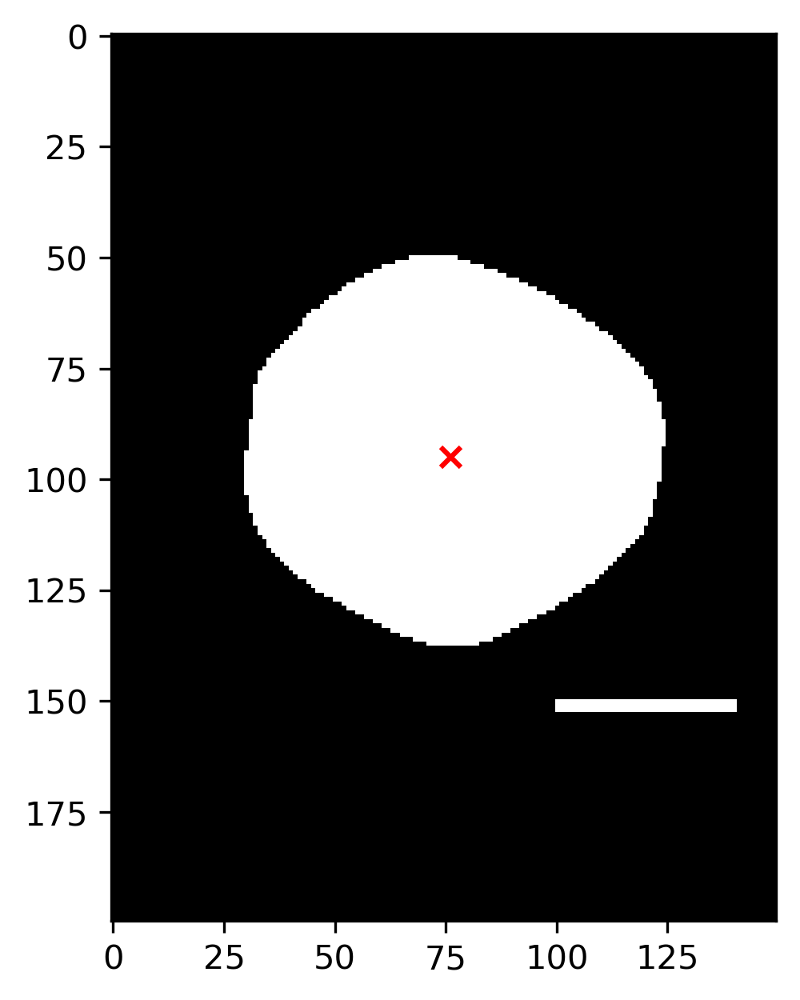

In [8]:
base_img = extract_masks(DAPI_masks, 61)[400:600, 300:450]
plt.imshow(~(add_scale_bar(base_img, .123, 5, 100, 150, 2)>0), cmap = 'Greys')
plt.scatter(76, 95, marker = 'x', c = 'red')

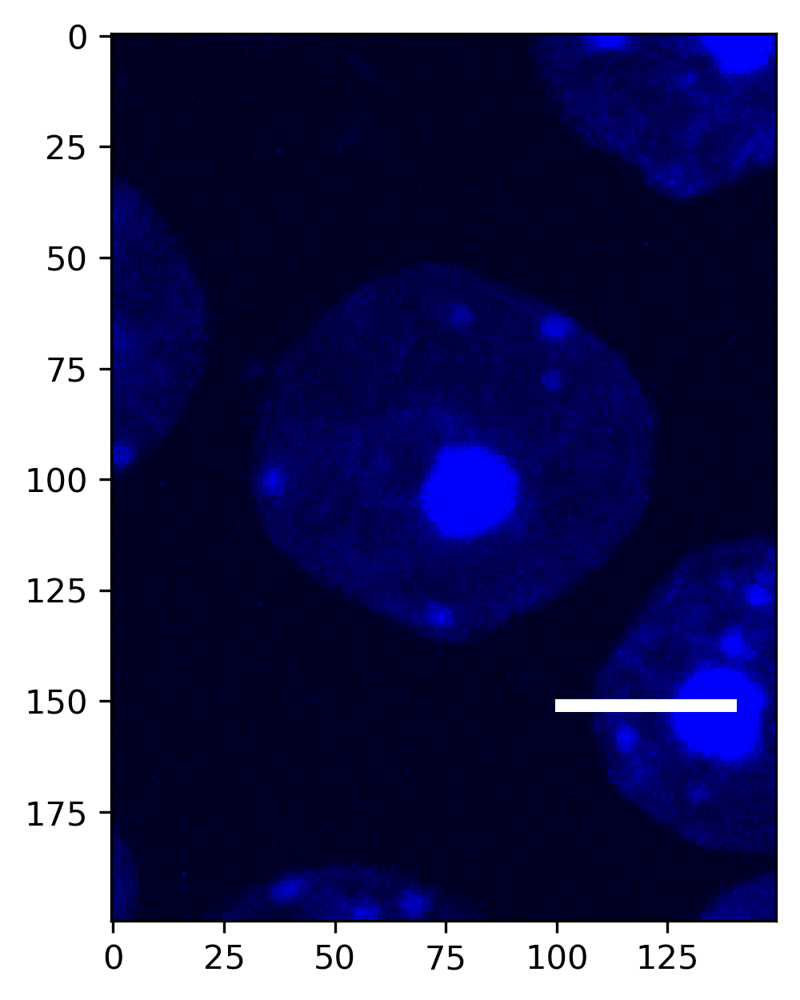

In [9]:
base_img = mp_DAPI[400:600, 300:450]
ax = grey_to_color(base_img, color = 'blue')
plt.imshow((add_scale_bar(ax, .123, 5, 100, 150, 2)))

In [10]:
def plot_3d_points(centers_of_mass, microns_per_pixel, view_angle=(45, 45)):
    """
    Plots the (x, y, z) coordinates of the centers of mass, with axes converted from pixels to microns.

    :param centers_of_mass: List of tuples containing (x, y, z) coordinates of the centers of mass.
    :param microns_per_pixel: Conversion factor from pixels to microns.
    :param view_angle: Tuple containing the view angle (elevation, azimuth) for the 3D plot.
    """
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Convert coordinates from pixels to microns
    xs = [coord[0] * microns_per_pixel for coord in centers_of_mass]
    ys = [coord[1] * microns_per_pixel for coord in centers_of_mass]
    zs = [coord[2] * microns_per_pixel for coord in centers_of_mass]

    ax.scatter(xs, ys, zs, c='r', marker='o')

    # Set axis labels
    ax.set_xlabel('micron', color='white')
    ax.set_ylabel('micron', color='white')
    ax.set_zlabel('micron', color='white')

    # Set tick colors to white
    ax.tick_params(axis='x', colors='white')
    ax.tick_params(axis='y', colors='white')
    ax.tick_params(axis='z', colors='white')


    # Set ticks for x, y, and z axes
    ax.set_xticks(np.arange(0, max(xs), 20))
    ax.set_yticks(np.arange(0, max(ys), 20))
    ax.set_zticks(np.arange(0, 13, 2))

    

    # Set limits for x, y, and z axes
    ax.set_xlim(0, max(xs))
    ax.set_ylim(0, max(ys))
    ax.set_zlim(0, 13)

    # Set view angle
    ax.view_init(view_angle[0], view_angle[1])

    # Move the z-axis to the opposite side
    ax.zaxis._axinfo['juggled'] = (1, 2, 0)

    # Set background color to transparent
    fig.patch.set_alpha(0.0)
    ax.patch.set_alpha(0.0)

    plt.show()

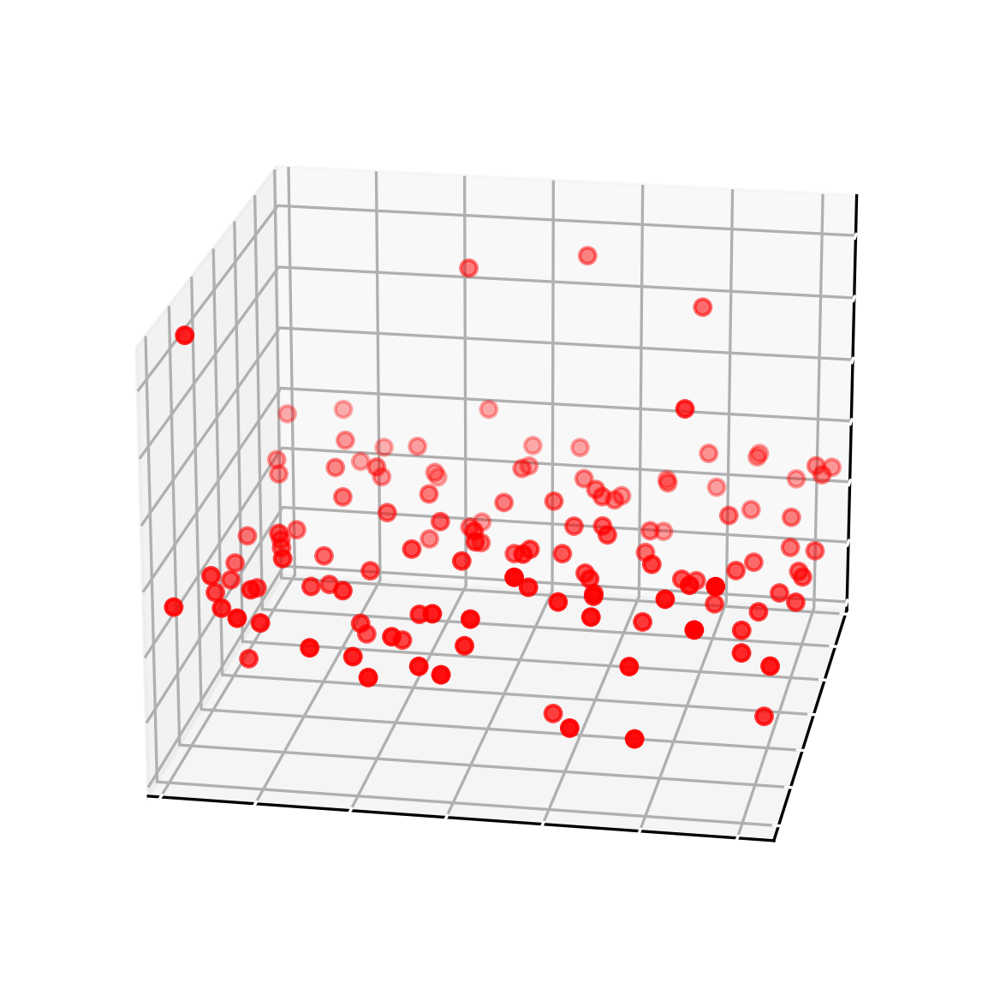

In [11]:
plot_3d_points(coords_3d, .123, (20,10))

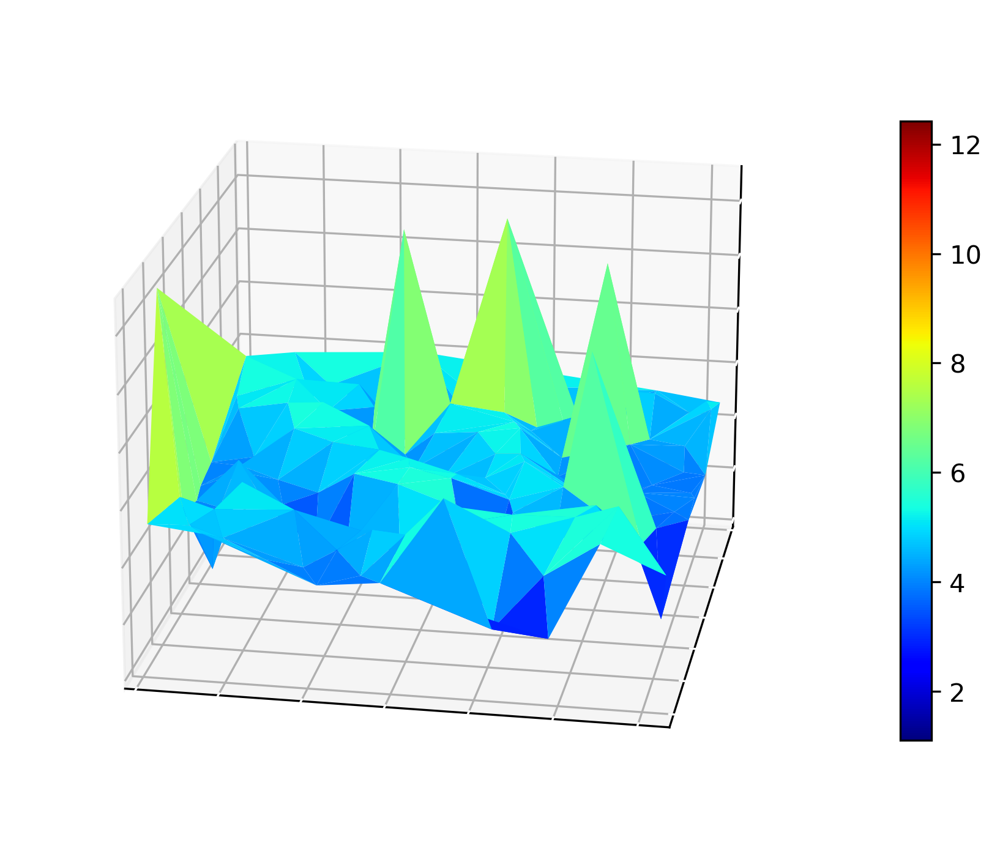

In [12]:
def plot_3d_surface(comp, microns_per_pixel, view_angle=(25, 45), cmap=cm.jet):
    """
    Plots a 3D surface using trisurf, with axes converted from pixels to microns and transparent background.

    Parameters:
    - comp: List of tuples containing (x, y, z) coordinates.
    - microns_per_pixel: Conversion factor from pixels to microns.
    - view_angle: Tuple specifying the (elevation, azimuth) for the view angle.
    - cmap: Colormap for the surface.

    Returns:
    - None: Displays the 3D plot.
    """
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Convert coordinates from pixels to microns
    xs = [coord[0] * microns_per_pixel for coord in comp]
    ys = [coord[1] * microns_per_pixel for coord in comp]
    zs = [coord[2] * microns_per_pixel for coord in comp]

    # Get the min and max of the z-values for consistent colormap limits
    z_min, z_max = min(zs), max(zs)

    surf = ax.plot_trisurf(xs, ys, zs,
                           cmap=cmap,
                           linewidth=0,
                           vmin=z_min,
                           vmax=z_max,
                           antialiased=True)
    fig.colorbar(surf, shrink=0.75)

    # Set axis labels
    ax.set_xlabel('micron', color='white')
    ax.set_ylabel('micron', color='white')
    ax.set_zlabel('micron', color='white')

    # Set ticks for x, y, and z axes
    ax.set_xticks(np.arange(0, max(xs), 20))
    ax.set_yticks(np.arange(0, max(ys), 20))
    ax.set_zticks(np.arange(0, 13, 2))

    # Set limits for x, y, and z axes
    ax.set_xlim(0, max(xs))
    ax.set_ylim(0, max(ys))
    ax.set_zlim(0, 13)

    # Set tick colors to white
    ax.tick_params(axis='x', colors='white')
    ax.tick_params(axis='y', colors='white')
    ax.tick_params(axis='z', colors='white')

    # Set view angle
    ax.view_init(*view_angle)

    # Move the z-axis to the opposite side
    ax.zaxis._axinfo['juggled'] = (1, 2, 0)

    # Set background color to transparent
    fig.patch.set_alpha(0.0)
    ax.patch.set_alpha(0.0)

    # Add grid lines to make axes more visible
    ax.grid(True)

    # Apply tight layout and show plot
    fig.tight_layout()
    plt.show()

plot_3d_surface(coords_3d, .123, view_angle = (20, 10))

In [13]:
np.median([z[2] for z in coords_3d])

38.0

# Visualization of closest points

In [14]:
def mod_plot_3d_points(centers_of_mass, point_index, view_angle=(45, 45)):
    """
    Plots the (x, y, z) coordinates of the centers of mass and highlights the 10 closest points to the given point index.

    :param centers_of_mass: List of tuples containing (x, y, z) coordinates of the centers of mass.
    :param point_index: Index of the reference point to which the 10 closest points will be found.
    :param view_angle: Tuple specifying the (elevation, azimuth) for the view angle.
    """
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    xs = np.array([coord[0] for coord in centers_of_mass])
    ys = np.array([coord[1] for coord in centers_of_mass])
    zs = np.array([coord[2] for coord in centers_of_mass])

    # Reference point coordinates
    ref_x = xs[point_index]
    ref_y = ys[point_index]
    ref_z = zs[point_index]

    # Calculate distances from the reference point
    distances = np.sqrt((xs - ref_x)**2 + (ys - ref_y)**2 + (zs - ref_z)**2)

    # Get indices of the 10 closest points
    closest_indices = distances.argsort()[1:16]  # finds closest 15 

    # Indices of points that are not the 10 closest
    other_indices = [i for i in range(len(xs)) if i not in closest_indices and i != point_index]

    # Highlight the reference point in green
    ax.scatter(ref_x, ref_y, ref_z, c='g', marker='^', s=100, label='Reference Point')

    # Highlight the 10 closest points in blue
    ax.scatter(xs[closest_indices], ys[closest_indices], zs[closest_indices], c='b', marker='o', label='15 Closest Points')

    # Plot other points in red
    ax.scatter(xs[other_indices], ys[other_indices], zs[other_indices], c='r', marker='o', label='Other Points')

    ax.set_xlabel('X Coordinate')
    ax.set_ylabel('Y Coordinate')
    ax.set_zlabel('Z Coordinate')


    ax.view_init(view_angle[0], view_angle[1])
    
    ax.zaxis._axinfo['juggled'] = (1, 2, 0)

    # Place the legend on the left side
    ax.legend(loc='center left', bbox_to_anchor=(-0.2, 0.5))
    
    ax.legend()

    plt.show()

def mod_plot_3d_points(centers_of_mass, point_index, microns_per_pixel, view_angle=(45, 45)):
    """
    Plots the (x, y, z) coordinates of the centers of mass and highlights the 15 closest points to the given point index,
    with axes converted from pixels to microns and fonts set to black.

    :param centers_of_mass: List of tuples containing (x, y, z) coordinates of the centers of mass.
    :param point_index: Index of the reference point to which the 15 closest points will be found.
    :param microns_per_pixel: Conversion factor from pixels to microns.
    :param view_angle: Tuple specifying the (elevation, azimuth) for the view angle.
    """
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Convert coordinates from pixels to microns
    xs = np.array([coord[0] for coord in centers_of_mass]) * microns_per_pixel
    ys = np.array([coord[1] for coord in centers_of_mass]) * microns_per_pixel
    zs = np.array([coord[2] for coord in centers_of_mass]) * microns_per_pixel

    # Reference point coordinates
    ref_x = xs[point_index]
    ref_y = ys[point_index]
    ref_z = zs[point_index]

    # Calculate distances from the reference point
    distances = np.sqrt((xs - ref_x)**2 + (ys - ref_y)**2 + (zs - ref_z)**2)

    # Get indices of the 15 closest points
    closest_indices = distances.argsort()[1:16]

    # Indices of points that are not the 15 closest
    other_indices = [i for i in range(len(xs)) if i not in closest_indices and i != point_index]

    # Highlight the reference point in green
    ax.scatter(ref_x, ref_y, ref_z, c='g', marker='^', s=100, label='Reference Point')

    # Highlight the 15 closest points in blue
    ax.scatter(xs[closest_indices], ys[closest_indices], zs[closest_indices], c='b', marker='o', label='15 Closest Points')

    # Plot other points in red
    ax.scatter(xs[other_indices], ys[other_indices], zs[other_indices], c='r', marker='o', label='Other Points')

    # Set axis labels and their colors to black
    ax.set_xlabel('micron', color='white')
    ax.set_ylabel('micron', color='white')
    ax.set_zlabel('micron', color='white')

    # Set tick colors to white
    ax.tick_params(axis='x', colors='white')
    ax.tick_params(axis='y', colors='white')
    ax.tick_params(axis='z', colors='white')

    # Set ticks for x, y, and z axes
    ax.set_xticks(np.arange(0, max(xs), 20))
    ax.set_yticks(np.arange(0, max(ys), 20))
    ax.set_zticks(np.arange(0, max(zs), 2))

    # Set limits for x, y, and z axes
    ax.set_xlim(0, max(xs))
    ax.set_ylim(0, max(ys))
    ax.set_zlim(0, max(zs),2)

    ax.view_init(view_angle[0], view_angle[1])

    ax.zaxis._axinfo['juggled'] = (1, 2, 0)

    # Place the legend in the top left part of the screen
    ax.legend(loc='upper left')
    legend = plt.legend()
    plt.setp(legend.get_texts(), color='black')
    #ax.get_legend().remove()

    # Set background color to transparent
    fig.patch.set_alpha(0.0)
    ax.patch.set_alpha(0.0)

    plt.show()


C:\Users\Luis\AppData\Local\Temp\ipykernel_14224\751137663.py:114: MatplotlibDeprecationWarning: Passing the emit parameter of set_zlim() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.set_zlim(0, max(zs),2)


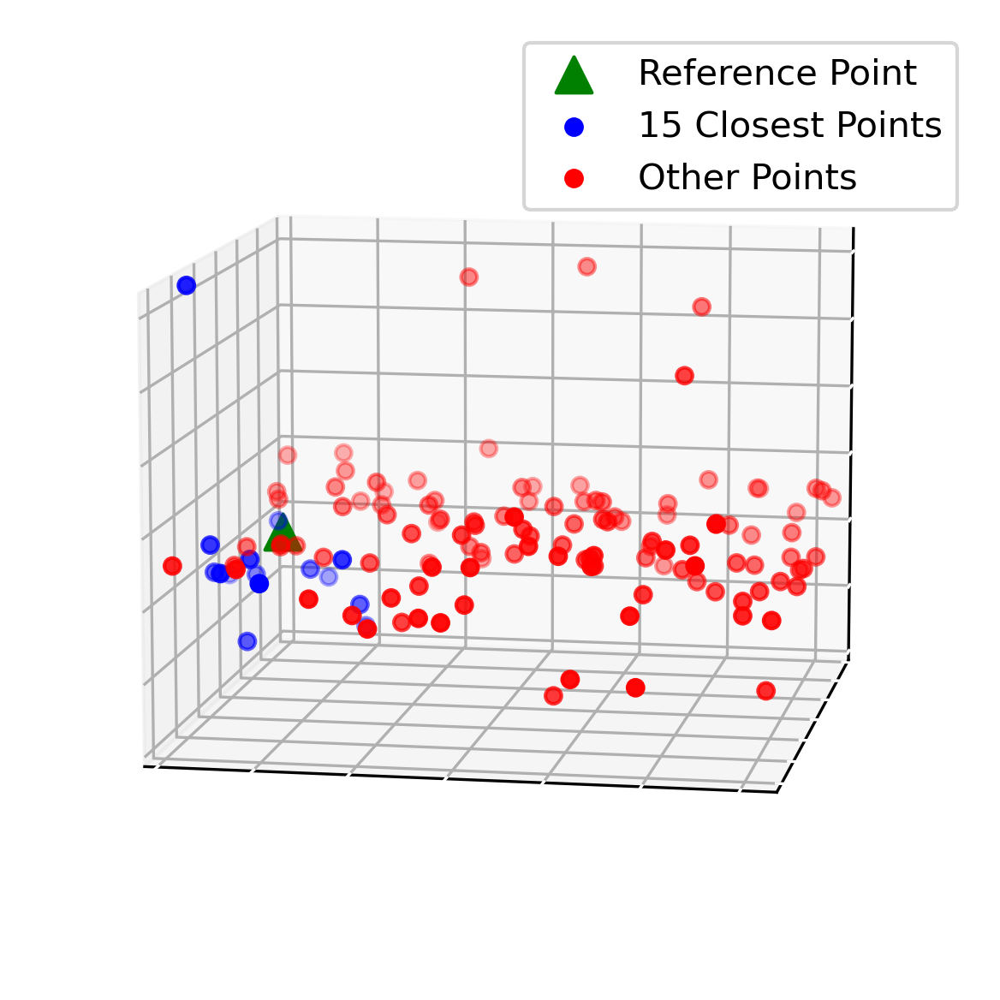

In [15]:
mod_plot_3d_points(coords_3d, 101, .123, (10, 10))
#mod_plot_3d_points(coords_3d, 81, .123, (50, 10))
#mod_plot_3d_points(coords_3d, 31, .123, (50, 10))


# Removing local outliers

In [16]:
def remove_outliers_local(centers_of_mass, num_closest_points=15, z_threshold=2):
    """
    Removes points that are outliers based on the z-values of their closest neighbors.

    :param centers_of_mass: List of tuples containing (x, y, z) coordinates of the centers of mass.
    :param num_closest_points: Number of closest points to consider for outlier detection.
    :param z_threshold: Number of standard deviations from the mean z-value to consider as an outlier.

    :return: Tuple containing filtered list of (x, y, z) coordinates and the indices of the filtered points.
    """
    if num_closest_points >= len(centers_of_mass):
        raise ValueError("num_closest_points must be less than the number of total points")

    filtered_data = []
    filtered_indices = []
    xs = np.array([coord[0] for coord in centers_of_mass])
    ys = np.array([coord[1] for coord in centers_of_mass])
    zs = np.array([coord[2] for coord in centers_of_mass])

    for i, (x, y, z) in enumerate(centers_of_mass):
        # Calculate distances from the current point to all other points
        distances = np.sqrt((xs - x)**2 + (ys - y)**2 + (zs - z)**2)

        # Get indices of the closest points, excluding the point itself
        closest_indices = distances.argsort()[1:num_closest_points+1]

        # Calculate mean and standard deviation of the z-values of these closest points
        z_closest = zs[closest_indices]
        mean_z = np.mean(z_closest)
        std_dev_z = np.std(z_closest)

        # Check if the current point is an outlier in z-value
        if abs(z - mean_z) <= z_threshold * std_dev_z:
            filtered_data.append((x, y, z))
            filtered_indices.append(i)

    return filtered_data, filtered_indices

filtered_coords_3d, filtered_idxs = remove_outliers_local(coords_3d)
filtered_DAPI_masks = extract_masks(DAPI_masks, filtered_idxs)

print('Removed masks:', len(coords_3d) - len(filtered_coords_3d))


Removed masks: 10


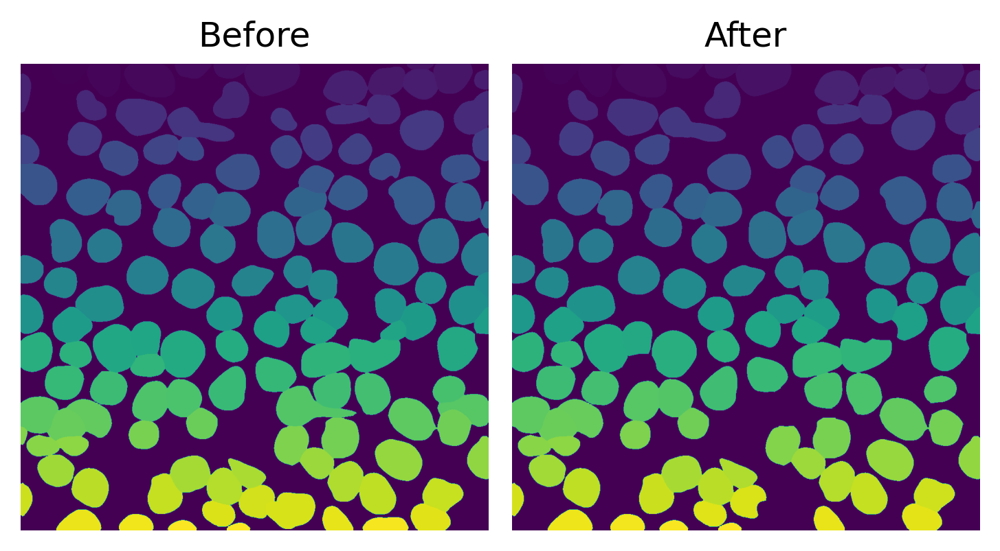

In [17]:
plot_2images(DAPI_masks, filtered_DAPI_masks)

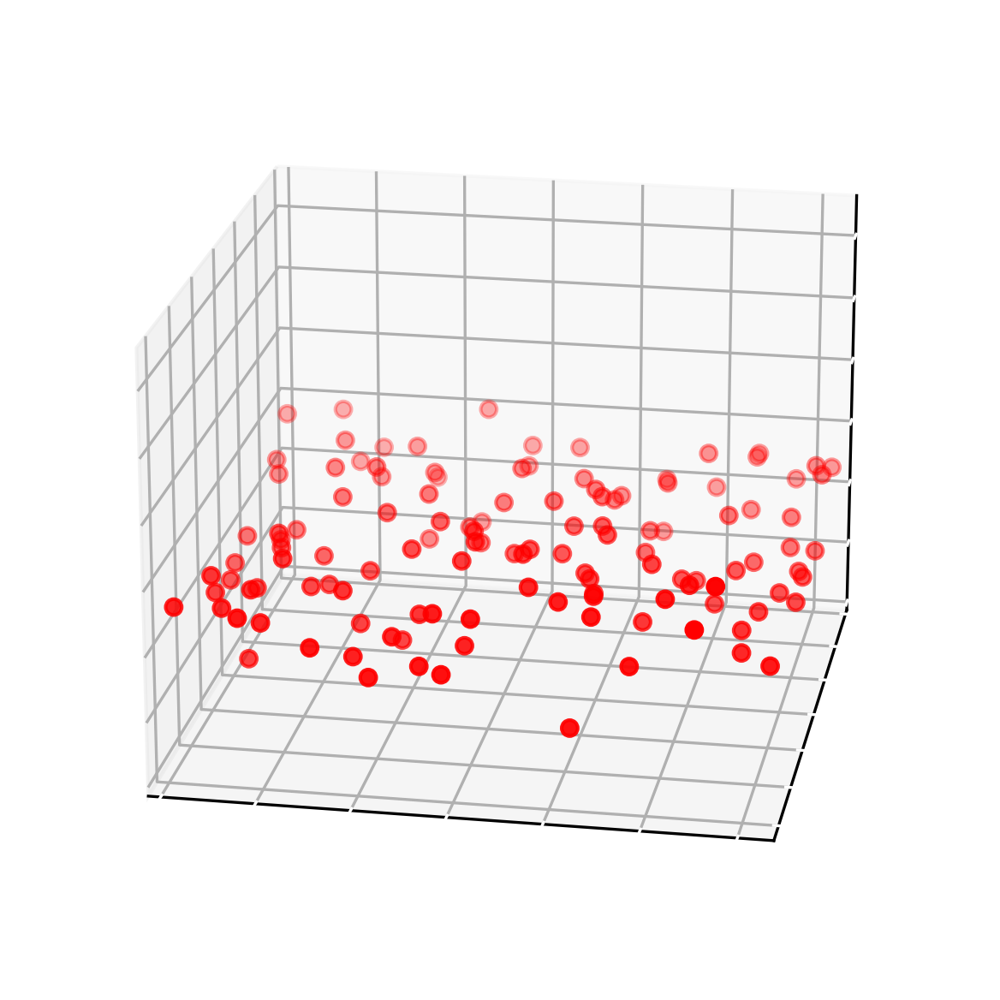

In [18]:
plot_3d_points(filtered_coords_3d, .123, view_angle = (20, 10))

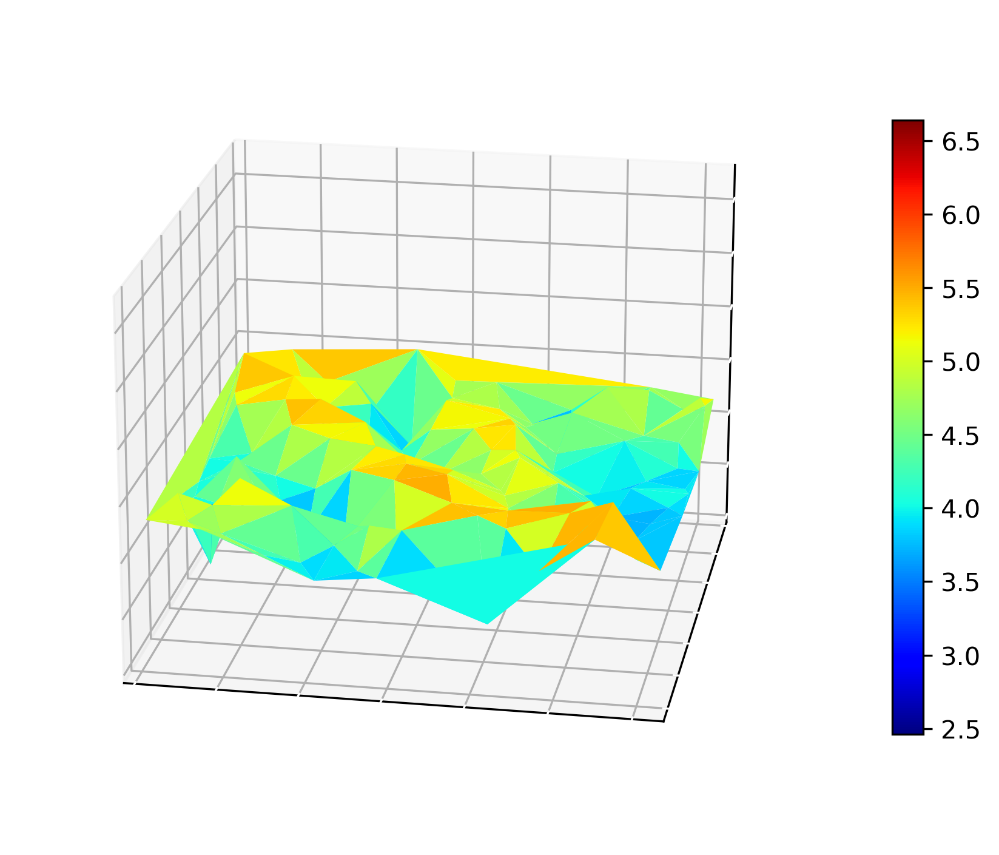

In [19]:
plot_3d_surface(filtered_coords_3d, .123, view_angle= (20, 10))

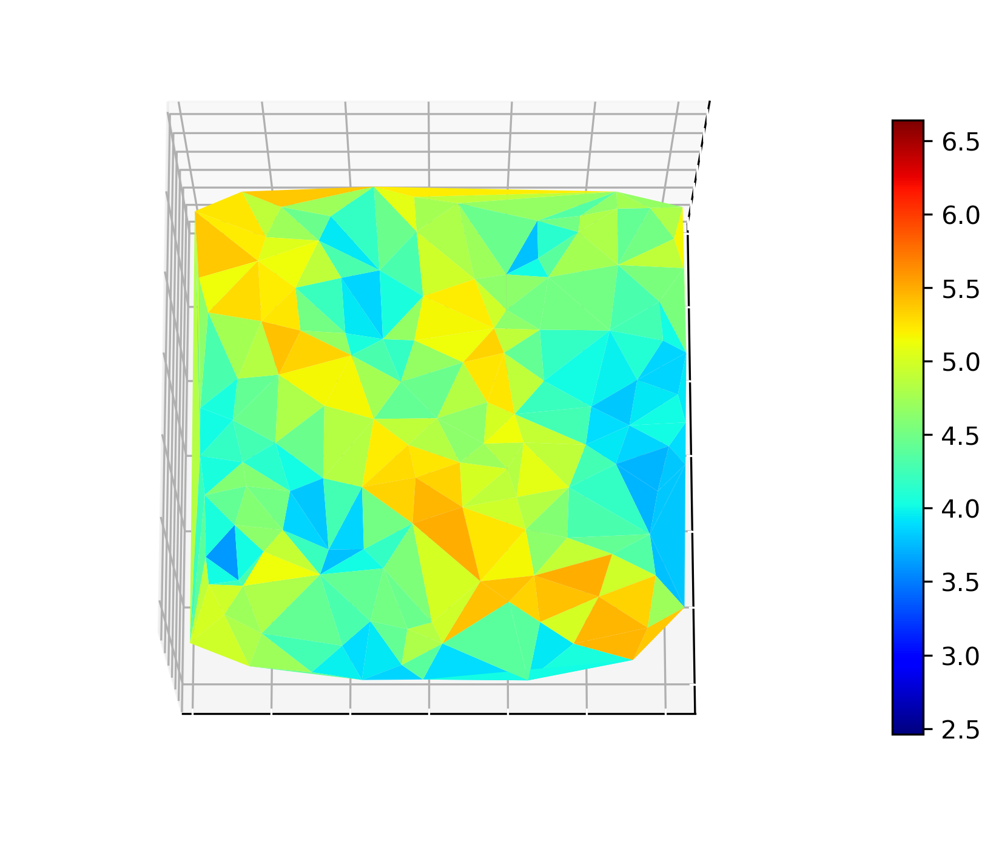

In [20]:
plot_3d_surface(filtered_coords_3d, .123, view_angle= (75,0))

In [21]:
def grey_to_color(image_slice, color:str = 'white'):

    # Create an empty image with the same dimensions but with 3 channels
    slice_rgb = np.zeros((image_slice.shape[0], image_slice.shape[1], 3), dtype=np.uint8)

    if color == 'magenta':
        slice_rgb[:, :, 0] = image_slice
        slice_rgb[:, :, 2] = image_slice
    
    if color == 'white':
        slice_rgb[:, :, 1] = image_slice
        slice_rgb[:, :, 0] = image_slice
        slice_rgb[:, :, 2] = image_slice

    if color == 'blue':
        slice_rgb[:, :, 2] = image_slice

    if color == 'green':
        slice_rgb[:, :, 1] = image_slice

    if color == 'red':
        slice_rgb[:, :, 0] = image_slice

    return slice_rgb

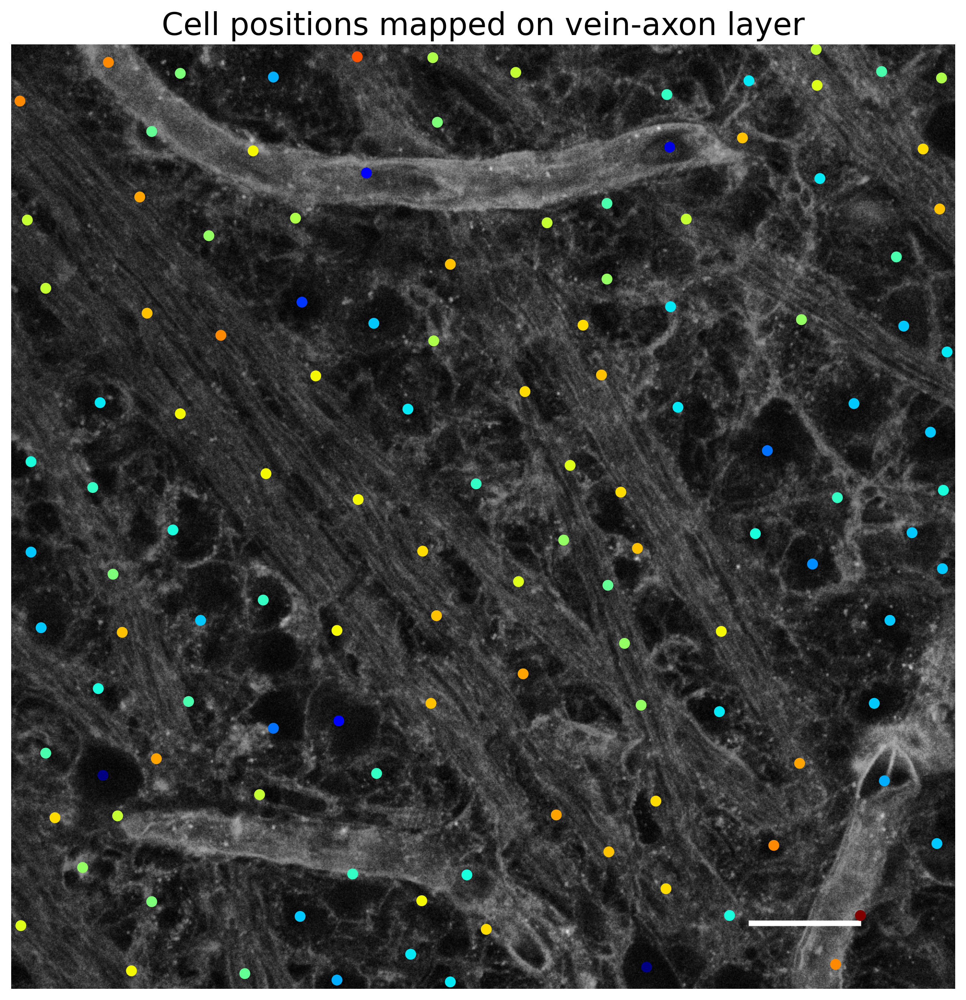

In [22]:
def plot_colormap_over_slice(comp, slice, cmap=cm.jet, font_size=10):
    fig, ax = plt.subplots(figsize=(10, 10))

    ys = np.array([coord[0] for coord in comp])
    xs = np.array([coord[1] for coord in comp])
    zs = np.array([coord[2] for coord in comp])

    # Get the min and max of the z-values for consistent colormap limits
    z_min, z_max = zs.min(), zs.max()

    # Plot the specified layer from WGA_stack as the background
    ax.imshow(slice)
    
    # Create scatter plot over the image
    scatter = ax.scatter(xs, ys, c=zs, cmap=cmap, vmin=z_min, vmax=z_max)
    #fig.colorbar(scatter, ax=ax, label='Z value')

    # Set axis labels, title, and tick parameters with font size
    ax.set_xlabel('X Axis', fontsize=font_size)
    ax.set_ylabel('Y Axis', fontsize=font_size)
    ax.set_title('Cell positions mapped on vein-axon layer', fontsize=font_size)
    ax.tick_params(axis='both', which='major', labelsize=font_size)

    plt.tight_layout()
    plt.axis('off')
    plt.show()



nuclei_zs = nuclei_slices(DAPI_stack, filtered_DAPI_masks)
z_intensities = np.sum(WGA_stack, axis=(1, 2))
ILM_layer = int(np.argmax(z_intensities)) / 2
nuclei_layer = np.sum(nuclei_zs) // len(nuclei_zs)
vein_axon_layer = int((ILM_layer + nuclei_layer) / 2)

slice = WGA_stack[vein_axon_layer, :, :]
slice = auto_brightness_contrast(grey_to_color(slice, 'white'))
slice = add_scale_bar(slice, .123, 15, 800, 950)
plot_colormap_over_slice(filtered_coords_3d, slice, font_size = 20)


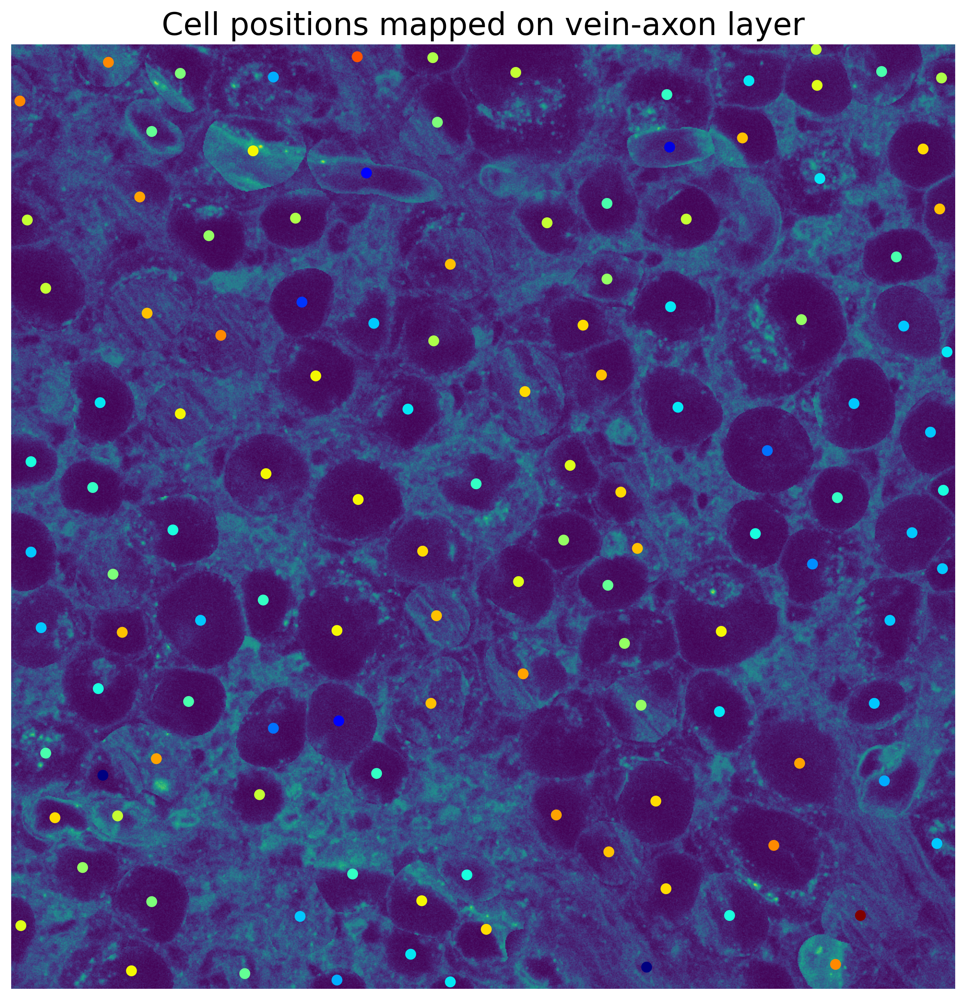

In [23]:
_, edited = cell_projector(WGA_stack, filtered_DAPI_masks, nuclei_zs)

plot_colormap_over_slice(filtered_coords_3d, auto_brightness_contrast(edited), font_size = 20)

In [24]:
def upload_training_cells(DAPI_stack, WGA_stack, single_mask, extra_space=50):
    sq_maski = square_mask(single_mask)

    _, _, comzi = nucleus_com(DAPI_stack, single_mask)  # Gets the nucleus stack of the middle of the cell

    # Calculate the bounding box of the square mask
    min_row, min_col, max_row, max_col = regionprops(sq_maski.astype(int))[0].bbox

    # Dimensions of the region of interest
    roi_height = max_row - min_row
    roi_width = max_col - min_col

    # Dimensions of the new canvas with extra space
    new_height = roi_height + 2 * extra_space
    new_width = roi_width + 2 * extra_space

    # Create new black canvas (filled with zeros)
    new_WGA_slice = np.zeros((new_height, new_width), dtype=WGA_stack.dtype)
    new_DAPI_slice = np.zeros((new_height, new_width), dtype=DAPI_stack.dtype)

    # Calculate the placement of the ROI in the new canvas
    new_min_row = extra_space
    new_min_col = extra_space

    # Extract the region of interest and place it in the center of the new canvas
    sq_WGA_slice = WGA_stack[comzi, min_row:max_row, min_col:max_col]
    new_WGA_slice[new_min_row:new_min_row + roi_height, new_min_col:new_min_col + roi_width] = sq_WGA_slice
    
    sq_DAPI_stack = DAPI_stack[comzi, min_row:max_row, min_col:max_col]
    sq_DAPI_slice = sq_DAPI_stack
    new_DAPI_slice[new_min_row:new_min_row + roi_height, new_min_col:new_min_col + roi_width] = sq_DAPI_slice

    return new_WGA_slice, new_DAPI_slice


In [25]:
### Model Configuration ###

model_2 = os.path.join(parent_directory, 'ImageAnalysis/cellpose_models/T5_WGA_V2')
model_stiches = os.path.join(parent_directory, 'ImageAnalysis/cellpose_models/T5_WGA_stiches')

Diameter: 95.35197952848173


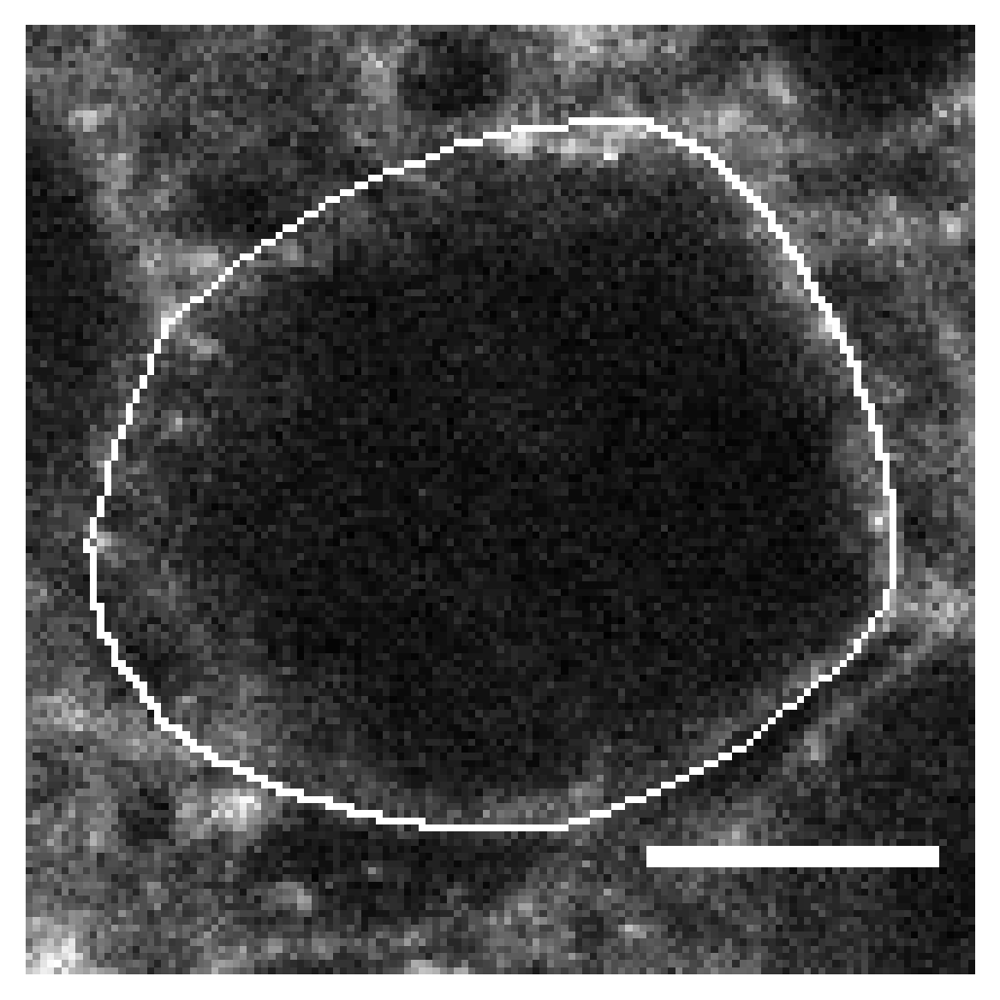

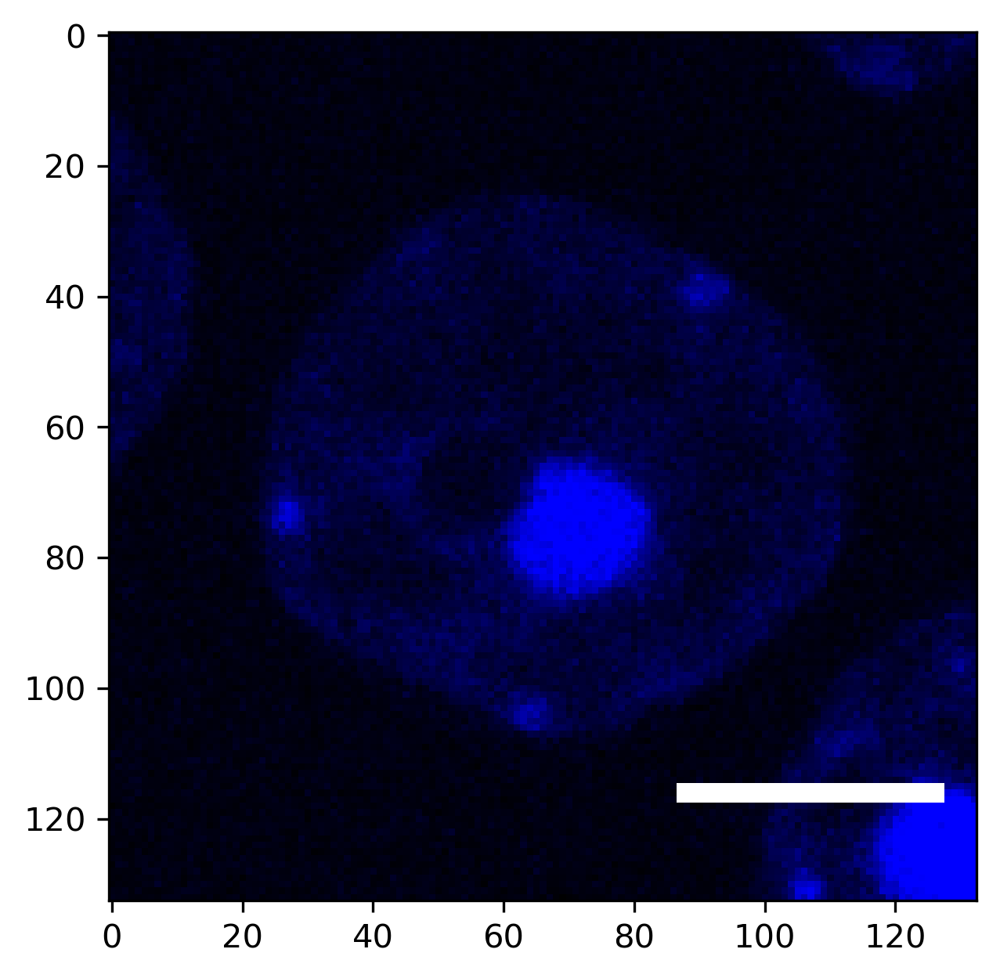

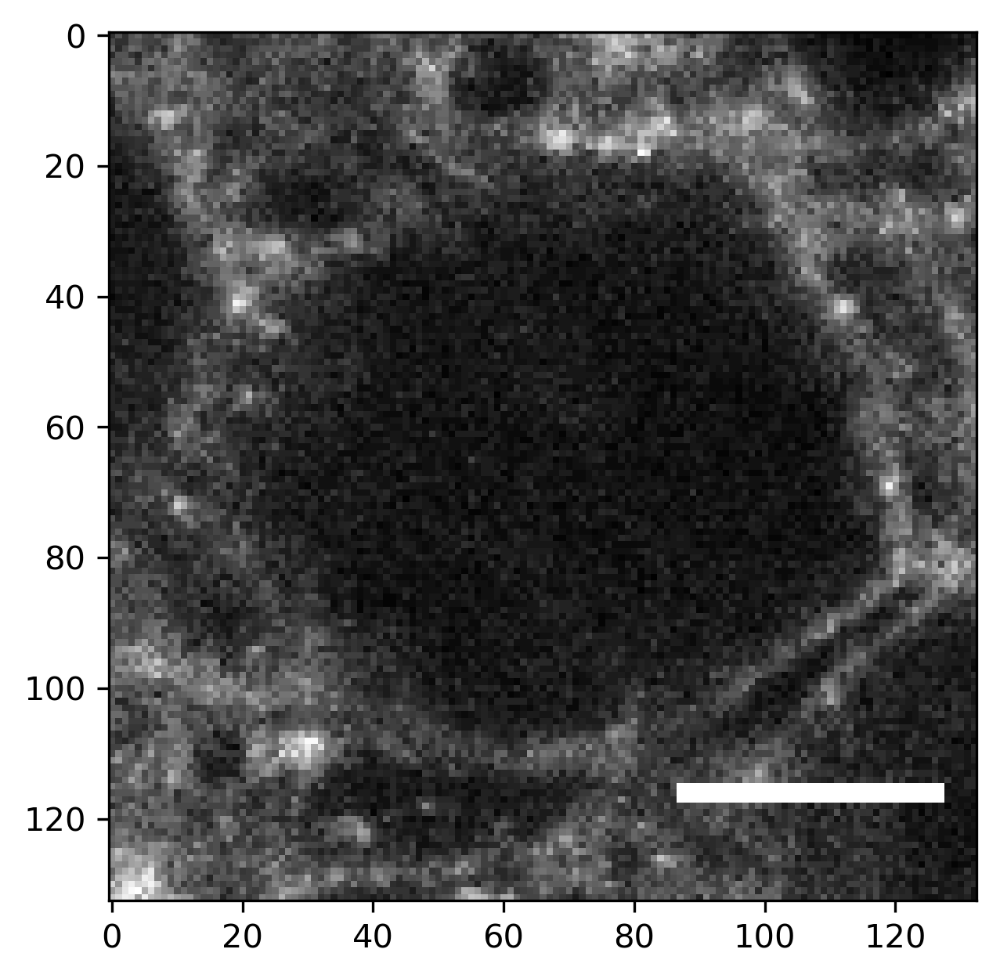

In [204]:
#61
def quickview_channels_model(mask_id):
    global DAPI_masks
    global WGA_stack

    extracted_mask = extract_masks(DAPI_masks, mask_id)
    diam = get_mask_diameter(extracted_mask)
    print('Diameter:', diam)

    sq_WGA_slice, sq_DAPI_slice = upload_training_cells(DAPI_stack, WGA_stack, extracted_mask)

    stack_image = np.stack((sq_WGA_slice, sq_DAPI_slice))

    ###
    model = models.CellposeModel(gpu = True, pretrained_model=model_2)
    masks1, flows, styles = model.eval(auto_brightness_contrast(sq_WGA_slice), diameter=diam-3, channels=[0,0])

    
    WGA_sq0 = remove_boundary(sq_WGA_slice, 50)
    WGA_sq0 = auto_brightness_contrast(grey_to_color(WGA_sq0, color = 'white'))

    mask_n = remove_boundary(masks1, 50)
    mask_con = get_contour_mask(mask_n)
    WGA_sq0[mask_con.astype(bool)] = [255,255,255]

    WGA_sq0 = add_scale_bar(WGA_sq0, .123, 5, 87, 115, 2)

    plt.imshow(WGA_sq0)
    plt.axis('off')
    plt.show()

    DAPI_sq = remove_boundary(sq_DAPI_slice, 50)
    DAPI_sq = grey_to_color(DAPI_sq, color = 'blue')
    DAPI_sq = add_scale_bar(DAPI_sq, .123, 5, 87, 115, 2)
    plt.imshow(DAPI_sq)
    plt.show()

    WGA_sq = remove_boundary(sq_WGA_slice, 50)
    WGA_sq = auto_brightness_contrast(grey_to_color(WGA_sq, color = 'white'))
    WGA_sq = add_scale_bar(WGA_sq, .123, 5, 87, 115, 2)
    plt.imshow(WGA_sq)
    plt.show


    return sq_WGA_slice, sq_DAPI_slice


test = quickview_channels_model(61)


In [27]:
from skimage.morphology import dilation, erosion, square

def get_contour_mask(mask):
    """
    Get a mask with only the contours of the original mask.

    :param mask: Binary mask image (numpy array).
    :return: Contour mask image (numpy array).
    """
    # Find contours at a constant value of 0.5
    contours = measure.find_contours(mask, .5)

    # Create an empty mask to draw the contours
    contour_mask = np.zeros_like(mask, dtype=np.uint8)

    # Draw the contours on the empty mask
    for contour in contours:
        contour = contour.astype(int)
        for point in contour:
            contour_mask[point[0], point[1]] = 1

    return contour_mask

def get_contour_mask_sq(mask):
    """
    Get a mask with only the contours of the original mask using dilation and erosion.

    :param mask: Binary mask image (numpy array).
    :return: Contour mask image (numpy array).
    """
    # Perform dilation and erosion
    dilated = dilation(mask, square(3))
    eroded = erosion(mask, square(3))
    
    # Subtract the eroded mask from the dilated mask to get the contours
    contour_mask = np.bitwise_xor(dilated, eroded)

    return contour_mask

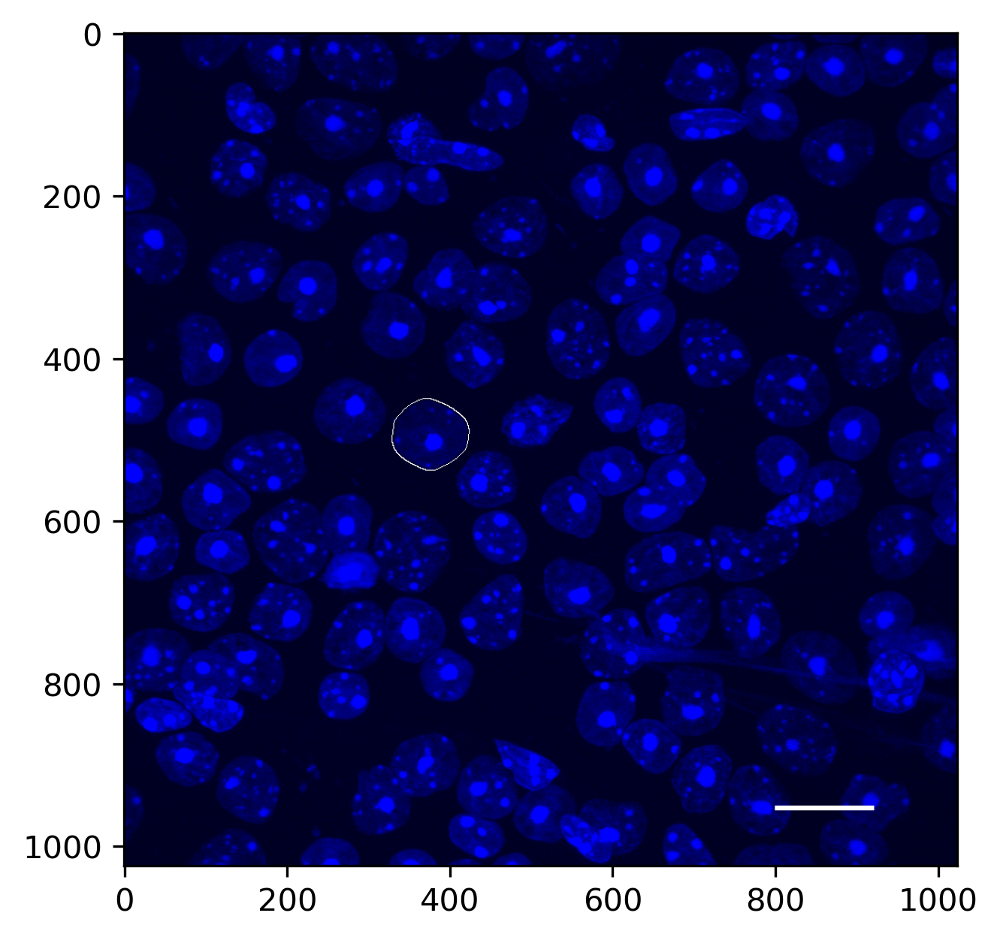

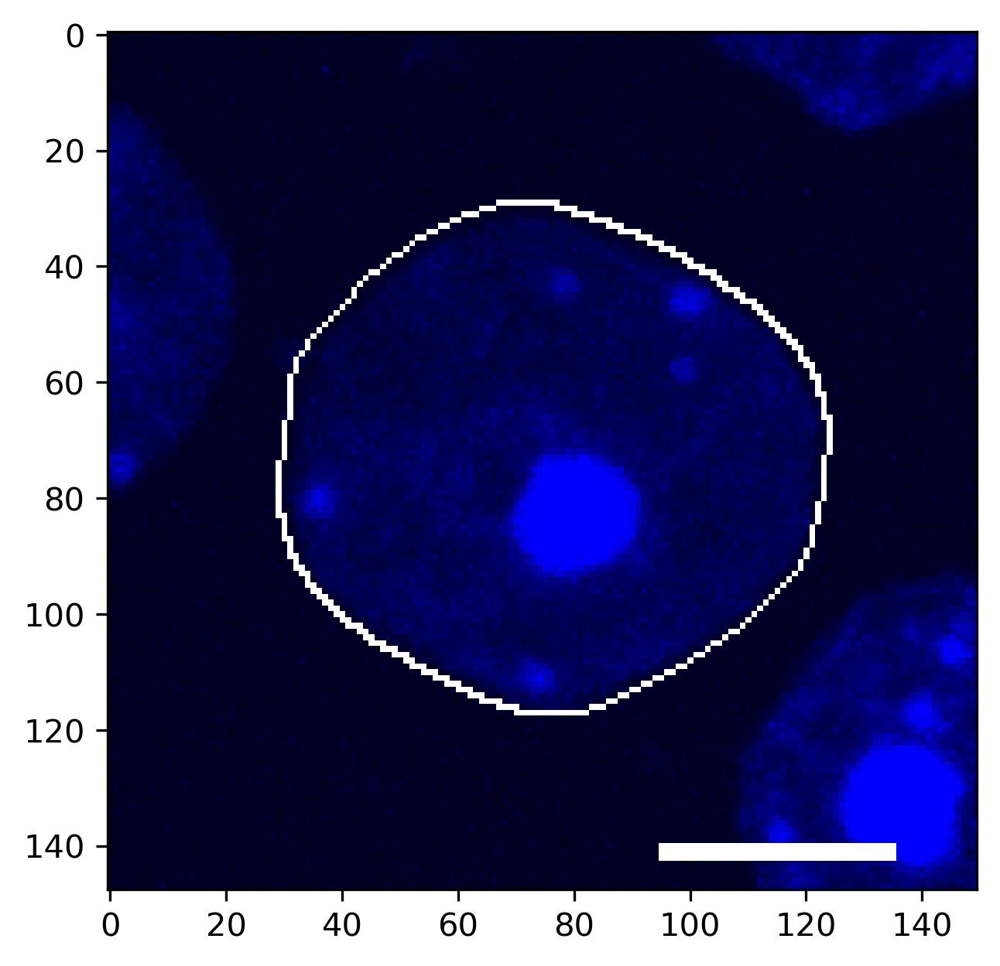

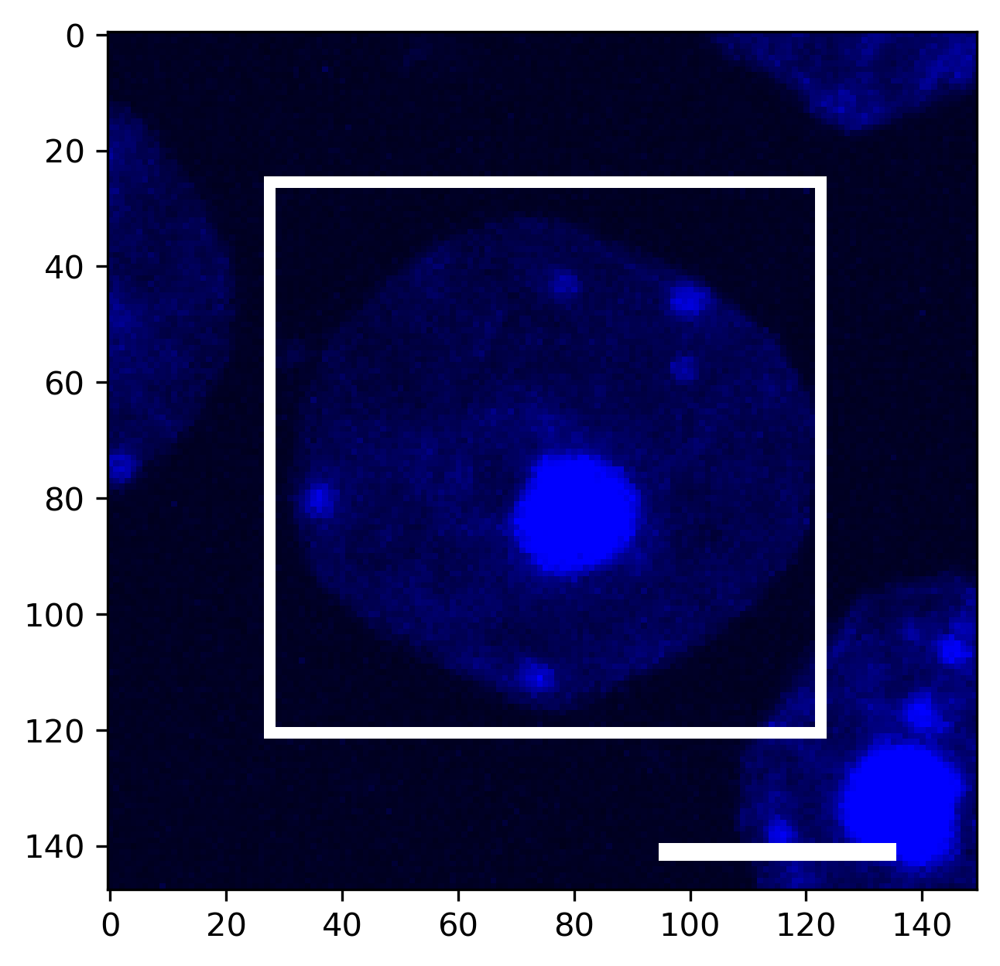

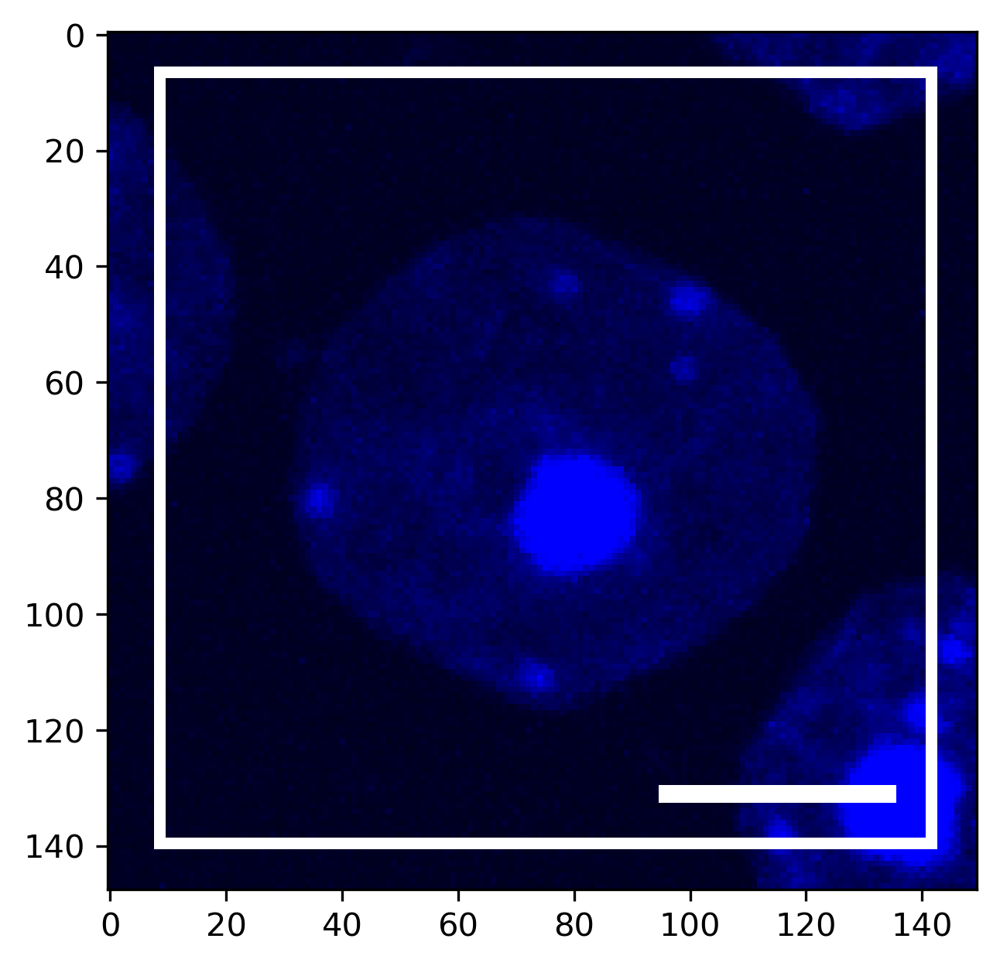

In [29]:
mask_oi = extract_masks(DAPI_masks, 61).astype(bool)
ex = grey_to_color(mp_DAPI, color = 'blue')
ex_sq = ex.copy()
ex_sq_ex = ex.copy()
ex[get_contour_mask(mask_oi).astype(bool)] = [255, 255, 255]
ex_cir = ex[420:568, 300:450]

ex_cir = add_scale_bar(ex_cir, .123, 5, 95, 140, 2)

plt.imshow(add_scale_bar(ex, .123, 15, 800, 950))
plt.show()

plt.imshow(ex_cir)
plt.show()

sq_mask = square_mask(extract_masks(DAPI_masks, 61).astype(bool), perc_increase= 0)
sq_mask_con = get_contour_mask_sq(sq_mask)
ex_sq[sq_mask_con] = [255, 255, 255]
ex_sq = ex_sq[420:568, 300:450]
ex_sq = add_scale_bar(ex_sq, .123, 5, 95, 140, 2)
plt.imshow(ex_sq)
plt.show()


sq_mask = square_mask(extract_masks(DAPI_masks, 61).astype(bool))
sq_mask_con_ex = get_contour_mask_sq(sq_mask)
ex_sq_ex[sq_mask_con_ex] = [255, 255, 255]
ex_sq_ex = ex_sq_ex[420:568, 300:450]
ex_sq_ex = add_scale_bar(ex_sq_ex, .123, 5, 95, 130, 2)
plt.imshow(ex_sq_ex)
plt.show()

In [150]:
def extract_square_proj_expand_mod(single_mask, extra_pixels = 50):
    '''
    Modification of upload_training_cells

    Usually modularity is important, however it's more practical that these functions feed into one another here
    '''
    sq_maski = square_mask(single_mask)

    # Calculate the bounding box of the square mask
    min_row, min_col, max_row, max_col = regionprops(sq_maski.astype(int))[0].bbox

    # Dimensions of the region of interest
    roi_height = max_row - min_row
    roi_width = max_col - min_col

    # Dimensions of the new canvas with extra space
    new_height = roi_height + 2 * extra_pixels 
    new_width = roi_width + 2 * extra_pixels 


    # Calculate the placement of the ROI in the new canvas
    new_min_row = extra_pixels 
    new_min_col = extra_pixels

    #plt.imshow(single_mask)
    #plt.show()


    n_mask = single_mask.copy()

    return n_mask[min_row:max_row, min_col:max_col]

def plot_overlaps(mask1, mask2, background_value:list = [0,0,0]):
    
    if mask1.shape != mask2.shape:
        raise Exception("Mask shapes do not match")

    height, width = mask1.shape
    base_array1 = np.zeros((height, width, 3), np.uint8)
    base_array2 = np.zeros((height, width, 3), np.uint8)

    base_array1[mask1 != 0] = [0, 0, 110]
    base_array2[mask2 != 0] = [120, 120, 120]

    combined_array = base_array1 + base_array2

    # changing background
    sums = combined_array.sum(axis = -1)
    background_mask = (sums == 0)
    combined_array[background_mask] = background_value

    plt.imshow(add_scale_bar(combined_array, .123, 5, 85, 120, 2))
    plt.show()
    plt.axis('off')

Diameter: 95.35197952848173


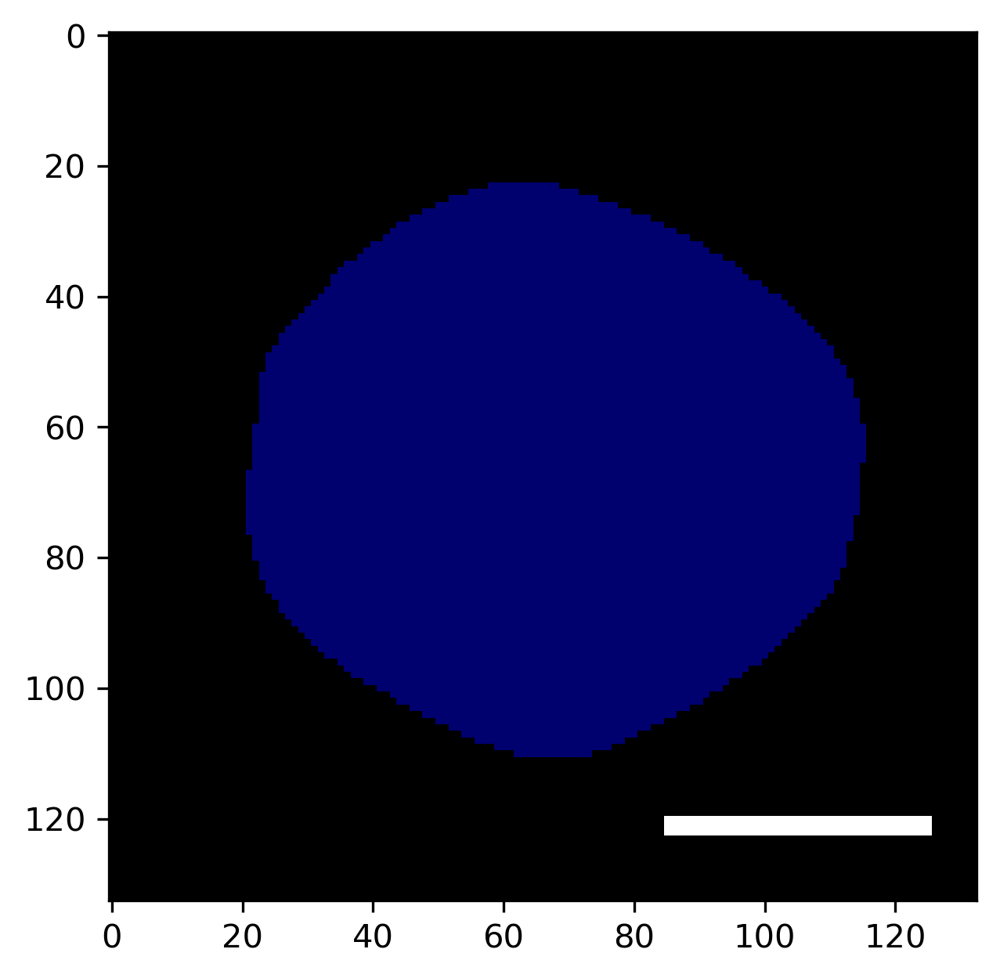

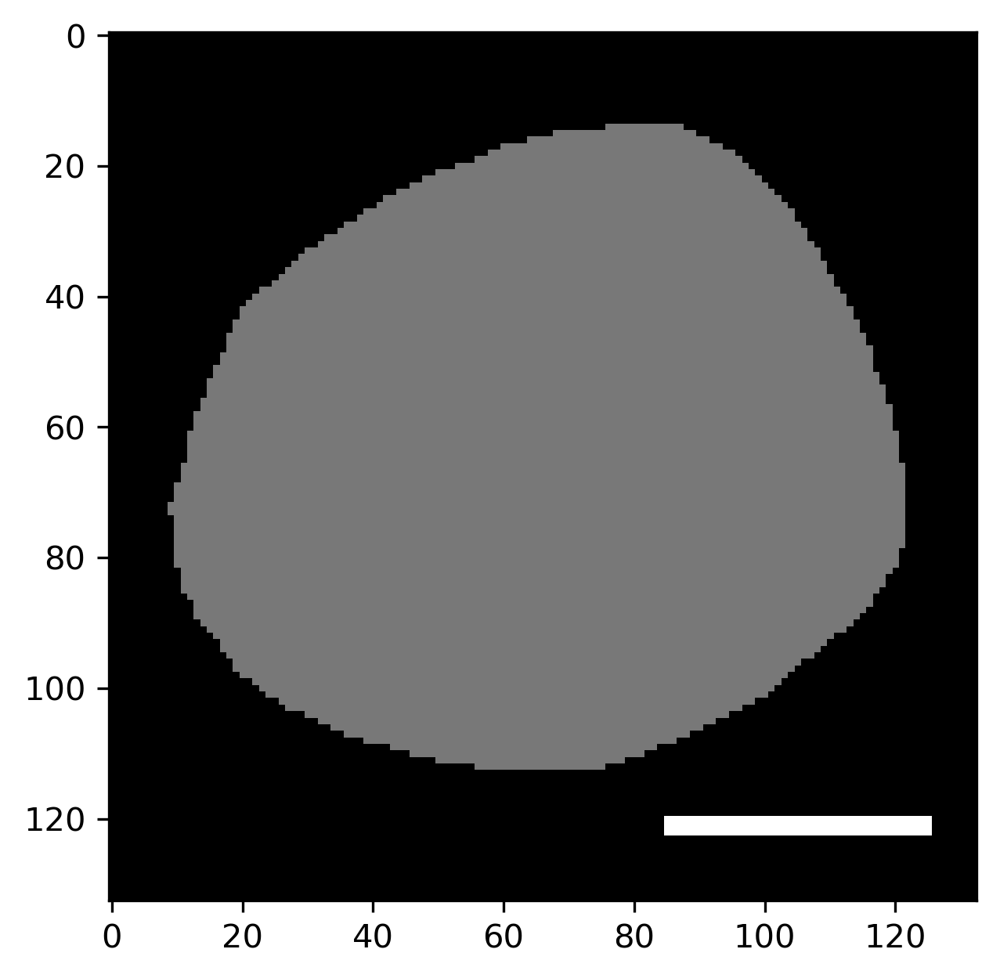

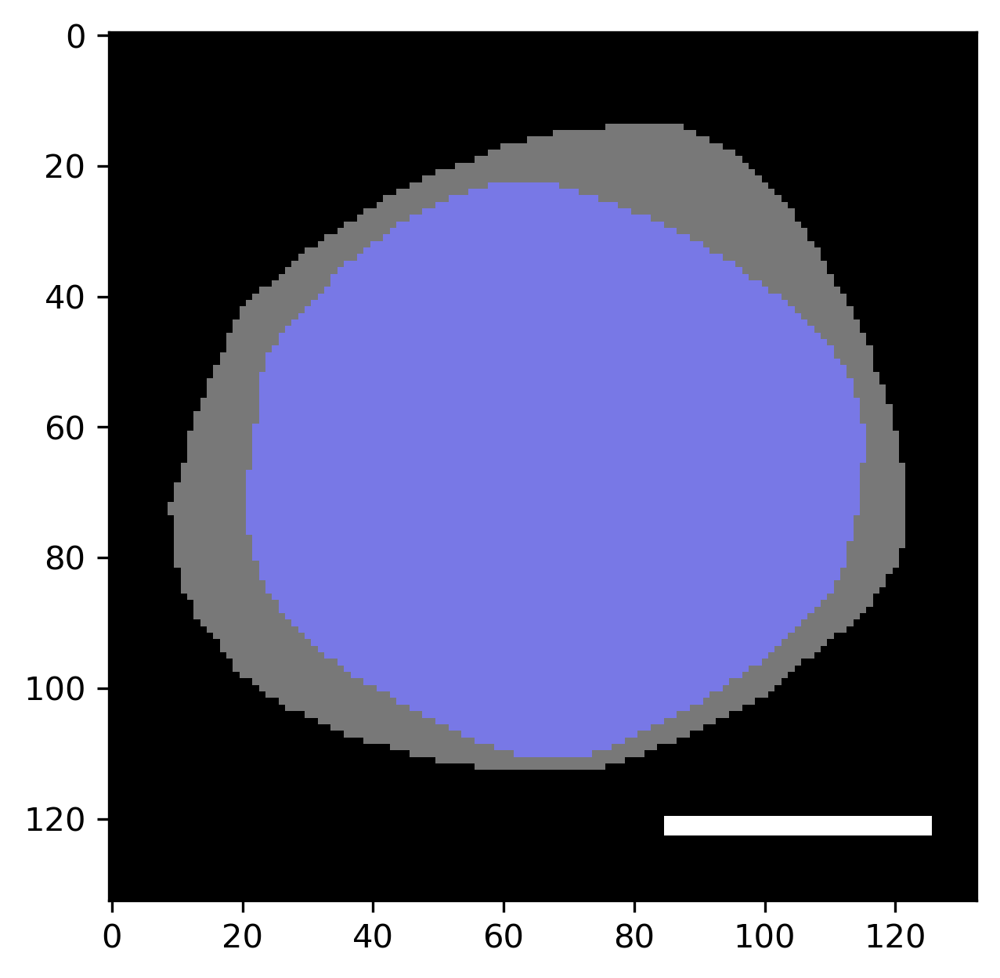

313


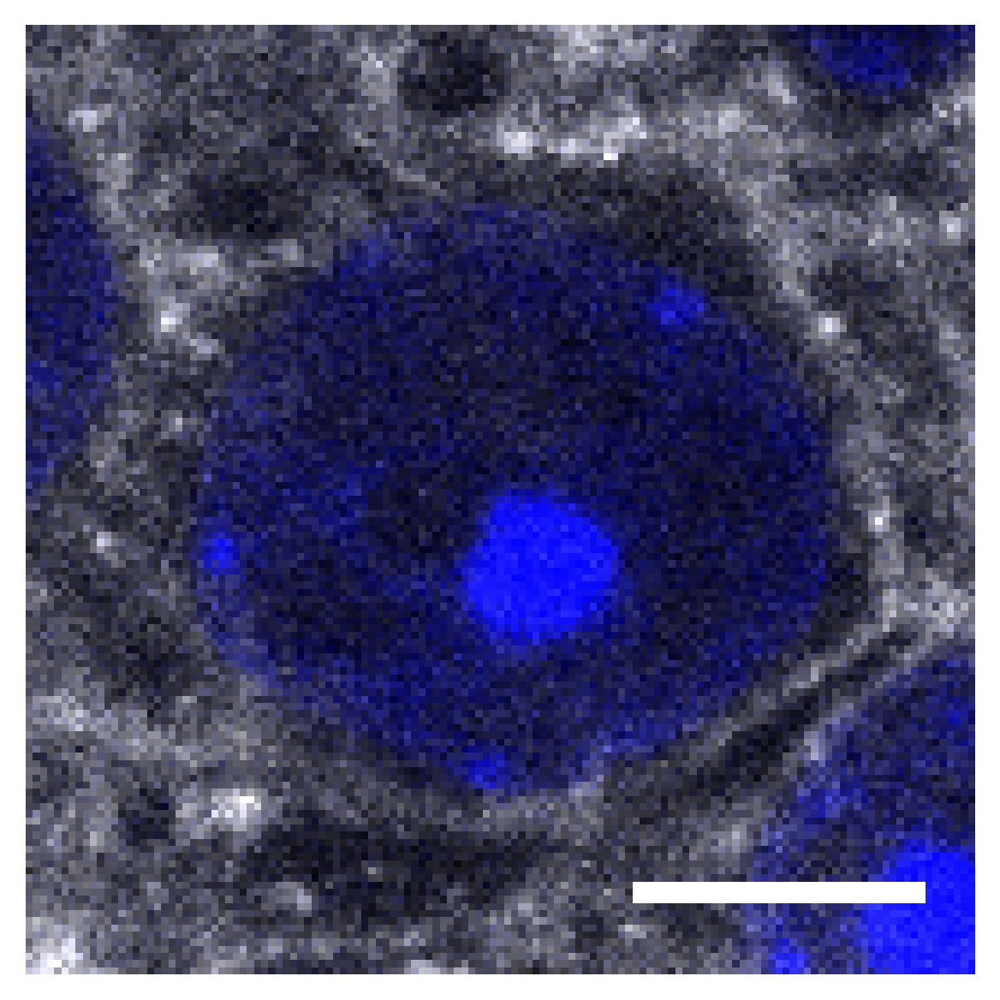

In [200]:
#61
def quickview_channels_model_mod2(mask_id):
    global DAPI_masks
    global WGA_stack

    extracted_mask = extract_masks(DAPI_masks, mask_id)
    diam = get_mask_diameter(extracted_mask)
    print('Diameter:', diam)

    sq_WGA_slice, sq_DAPI_slice = upload_training_cells(DAPI_stack, WGA_stack, extracted_mask)

    stack_image = np.stack((sq_WGA_slice, sq_DAPI_slice))

    ###
    model = models.CellposeModel(gpu = True, pretrained_model=model_2)
    masks1, flows, styles = model.eval(auto_brightness_contrast(sq_WGA_slice), diameter=diam-3, channels=[0,0])

    
    WGA_sq0 = remove_boundary(sq_WGA_slice, 50)
    WGA_sq0 = auto_brightness_contrast(grey_to_color(WGA_sq0, color = 'white'))

    mask_n = remove_boundary(masks1, 50)
    mask_con = get_contour_mask(mask_n)
    WGA_sq0[mask_con.astype(bool)] = [255,255,255]

    WGA_sq0 = add_scale_bar(WGA_sq0, .123, 5, 85, 120, 2)

    #plt.imshow(WGA_sq0)
    #plt.axis('off')
    #plt.show()

    old = extract_square_proj_expand_mod(extract_masks(DAPI_masks, 61), 0)


    masks1 = remove_boundary(masks1, 50)
    #plt.imshow(masks1)

    blue_mask = to_rgb(old, [0,0,110])
    white_mask = to_rgb(masks1, [120,120,120])

    plt.imshow(add_scale_bar(blue_mask, .123, 5, 85, 120, 2))
    plt.show()

    plt.imshow(add_scale_bar(white_mask, .123, 5, 85, 120, 2))
    plt.show()

    plot_overlaps(old, masks1)

    wga_new = remove_boundary(sq_WGA_slice, 50)
    dapi_new = remove_boundary(sq_DAPI_slice, 50)

    wga_rgb = auto_brightness_contrast(grey_to_color(wga_new, 'white'))
    dapi_rgb = grey_to_color(dapi_new, 'blue')

    base_image = np.zeros_like(wga_rgb).astype(np.uint16)
    base_image[:,:,0] = wga_rgb[:,:,0]
    base_image[:,:,1] = wga_rgb[:,:,0]
    #base_image[:,:,2] = wga_rgb[:,:,0]
    base_image[:,:,2] = np.clip(wga_rgb[:,:,0].astype(np.uint16) + dapi_rgb[:,:,2].astype(np.uint16), 0, 255)

    base_image = base_image.astype(np.uint8)
    base_image = add_scale_bar(base_image, .123, 5, 85, 120, 2)

    print(np.max(wga_rgb[:,:,0].astype(np.uint16) + dapi_rgb[:,:,2].astype(np.uint16)))


    plt.imshow(base_image)

    return 


test = quickview_channels_model_mod2(61)
